# **Import library**

In [ ]:
!git clone https://github.com/NVlabs/stylegan3.git

Cloning into 'stylegan3'...
remote: Enumerating objects: 212, done.
remote: Counting objects: 100% (4/4), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 212 (delta 0), reused 0 (delta 0), pack-reused 208 (from 2)
Receiving objects: 100% (212/212), 4.17 MiB | 40.70 MiB/s, done.
Resolving deltas: 100% (98/98), done.


In [ ]:
!nvidia-smi


Sun Feb  2 09:21:09 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   65C    P8             12W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
!pip install Ninja -q
!pip install imageio-ffmpeg -q
!pip install youtube-dl -q

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import os

# **Load Model**

In [ ]:
url = "/content/stylegan3-anime-face-gen.pkl"

# **Generate a Image**

In [ ]:
seed = 254 #@param {type: "slider", min:1, max:999, step:1}
!python /content/stylegan3/gen_images.py \
  --network=$url \
  --outdir=/content/generated-images \
  --seeds=$seed \
  --trunc=0.7


Loading networks from "/content/stylegan3-anime-face-gen.pkl"...
Generating image for seed 254 (0/1) ...
Setting up PyTorch plugin "bias_act_plugin"... /usr/local/lib/python3.11/dist-packages/torch/utils/cpp_extension.py:1964: UserWarning: TORCH_CUDA_ARCH_LIST is not set, all archs for visible cards are included for compilation. 
If this is not desired, please set os.environ['TORCH_CUDA_ARCH_LIST'].
  warnings.warn(
Done.
Setting up PyTorch plugin "filtered_lrelu_plugin"... /usr/local/lib/python3.11/dist-packages/torch/utils/cpp_extension.py:1964: UserWarning: TORCH_CUDA_ARCH_LIST is not set, all archs for visible cards are included for compilation. 
If this is not desired, please set os.environ['TORCH_CUDA_ARCH_LIST'].
  warnings.warn(
Done.


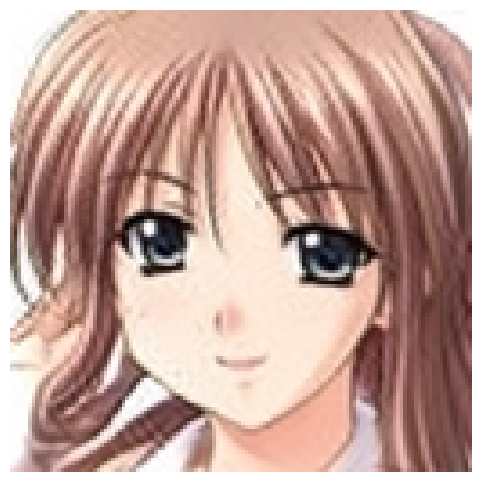

In [ ]:
# Định dạng seed với 4 chữ số
formatted_seed = f'{seed:04d}'

# Tạo đường dẫn với seed có 4 chữ số
image_path = f'/content/generated-images/seed{formatted_seed}.png'
image = Image.open(image_path)

# Hiển thị hình ảnh
plt.figure(figsize=(6, 6))
plt.axis('off')
plt.imshow(image)
plt.show()

# **Generate Images**

In [ ]:
start = 1  # @param {type: "slider", min:1, max:999, step:1}
end = 51  # @param {type: "slider", min:1, max:999, step:1}

# Tạo danh sách seeds từ start đến end
seeds = list(range(start, end + 1))

# Lệnh python để tạo hình ảnh với các seeds
for seed in seeds:
    !python /content/stylegan3/gen_images.py \
        --network=$url \
        --outdir=/content/results \
        --seeds=$seed \
        --trunc=0.7


Loading networks from "/content/stylegan3-anime-face-gen.pkl"...
Generating image for seed 1 (0/1) ...
Setting up PyTorch plugin "bias_act_plugin"... /usr/local/lib/python3.11/dist-packages/torch/utils/cpp_extension.py:1964: UserWarning: TORCH_CUDA_ARCH_LIST is not set, all archs for visible cards are included for compilation. 
If this is not desired, please set os.environ['TORCH_CUDA_ARCH_LIST'].
  warnings.warn(
Done.
Setting up PyTorch plugin "filtered_lrelu_plugin"... /usr/local/lib/python3.11/dist-packages/torch/utils/cpp_extension.py:1964: UserWarning: TORCH_CUDA_ARCH_LIST is not set, all archs for visible cards are included for compilation. 
If this is not desired, please set os.environ['TORCH_CUDA_ARCH_LIST'].
  warnings.warn(
Done.
Loading networks from "/content/stylegan3-anime-face-gen.pkl"...
Generating image for seed 2 (0/1) ...
Setting up PyTorch plugin "bias_act_plugin"... /usr/local/lib/python3.11/dist-packages/torch/utils/cpp_extension.py:1964: UserWarning: TORCH_CUDA_

<ipython-input-9-d6df739143f9>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (6,6))


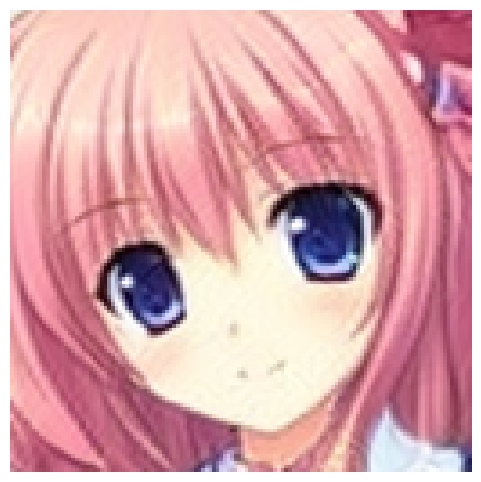

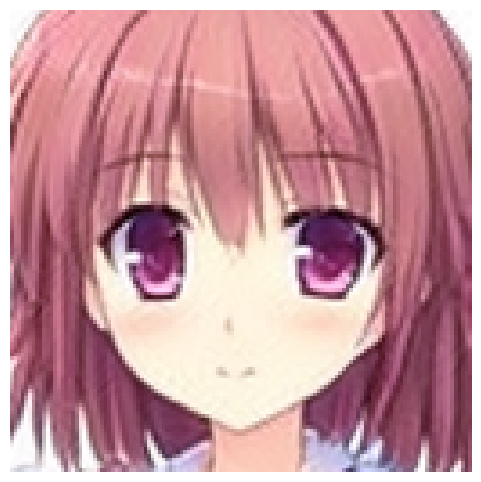

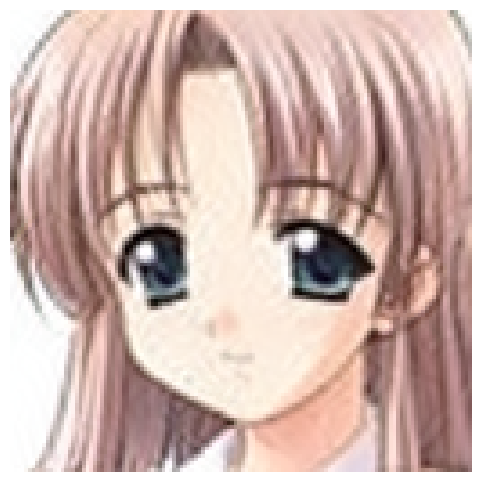

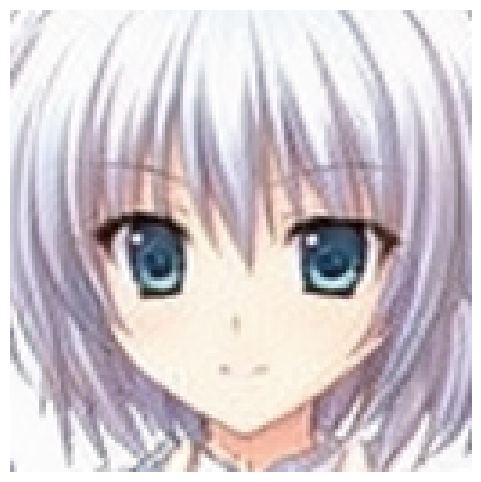

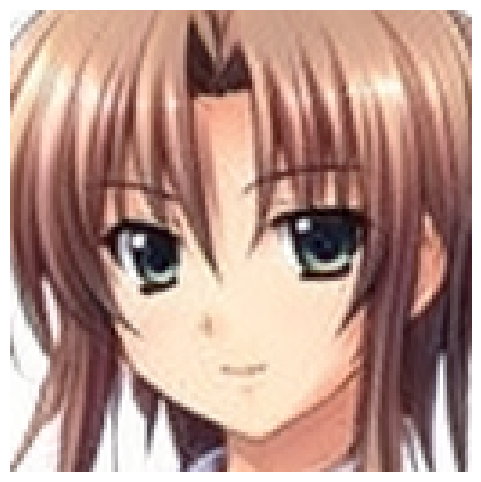

...

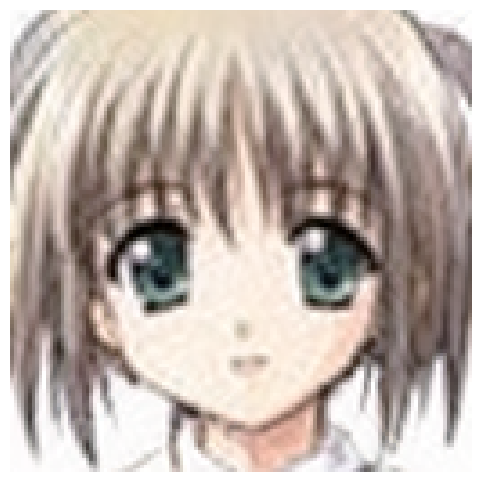

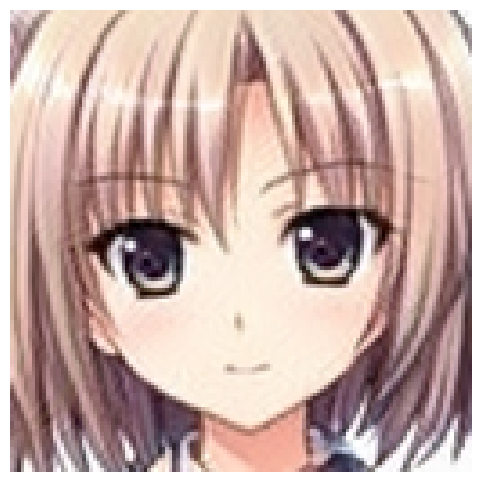

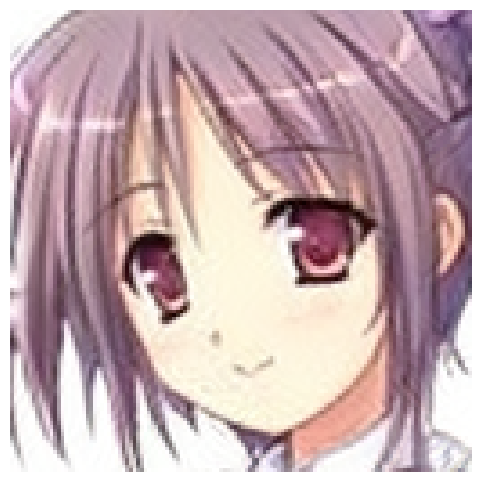

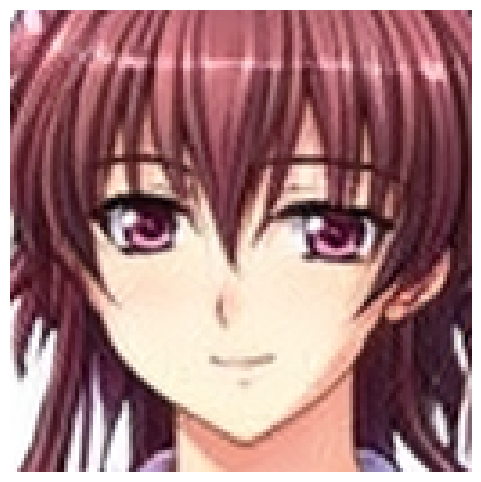

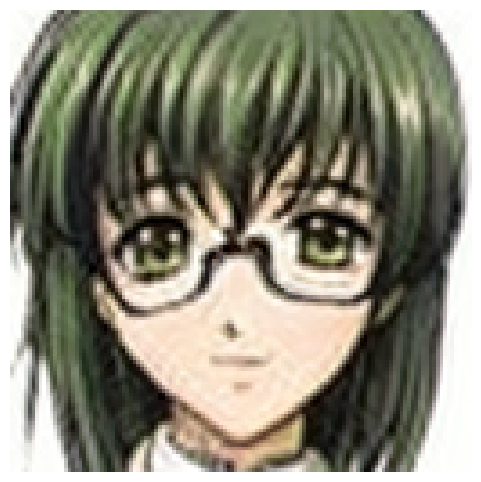

In [ ]:

for n_seed in range(start, end + 1):
  #print(n_seed)
  image = Image.open('/content/results/seed%04d.png' % n_seed)
  plt.figure(figsize = (6,6))
  plt.axis('off')
  plt.imshow(image)

# **Load Netork**

In [ ]:
%cd stylegan3

/content/stylegan3


In [11]:
import dnnlib
import legacy

In [12]:
device = torch.device('cuda')
def load_network(url, device):
  with dnnlib.util.open_url(url) as f:
    G = legacy.load_network_pkl(f)['G_ema'].to(device)
  return G

In [13]:
G = load_network(url, device)

In [14]:
def generate_z(G, seed):
  return np.random.RandomState(seed).randn(1, G.z_dim)

In [15]:
seed = np.random.randint(10000000)
print(seed)
z = generate_z(G, seed)
print(z.shape)

6156344
(1, 512)


In [16]:
def generate_image(device, G, z, truncation_psi=1.0, noise_mode='const', class_idx=None):
  z = torch.from_numpy(z).to(device)
  label = torch.zeros([1, G.c_dim], device=device)
  img = G(z, label, truncation_psi=truncation_psi, noise_mode=noise_mode)
  # (1, 3, 1024, 1024) -> (1024, 1024, 3)
  img = (img.permute(0,2,3,1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
  return Image.fromarray(img[0].cpu().numpy(), 'RGB')

In [17]:
def show_img(image):
  plt.axis('off')
  plt.imshow(image)
  plt.show()

# **Generate Image with NetWork**

Seed: 217


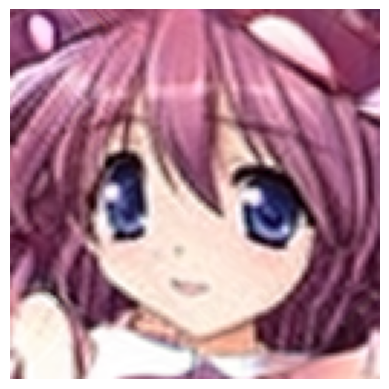

In [31]:
seed = 217  # @param {type: "slider", min:1, max:999, step:1}

print('Seed:', seed)
z = generate_z(G, seed)
img = generate_image(device, G, z)
show_img(img)

Seed:  4210


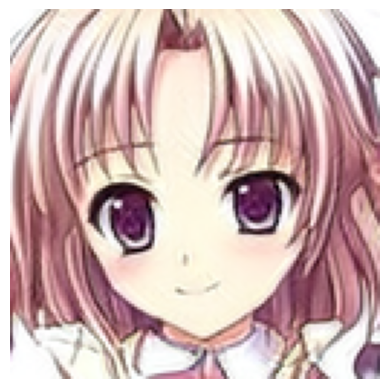

Seed:  4262


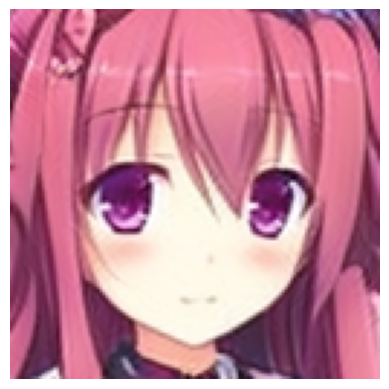

Seed:  4295


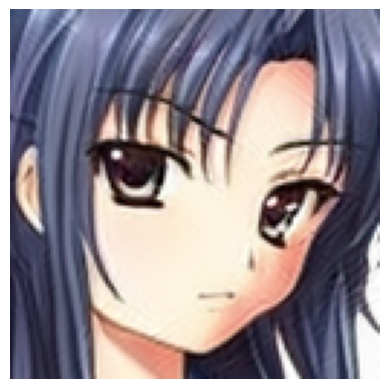

Seed:  4218


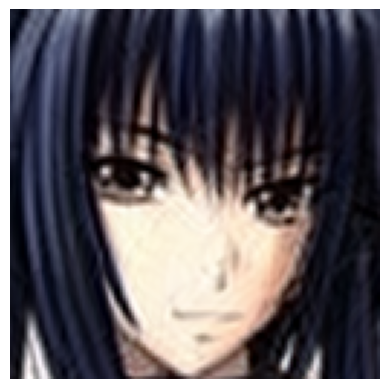

Seed:  500


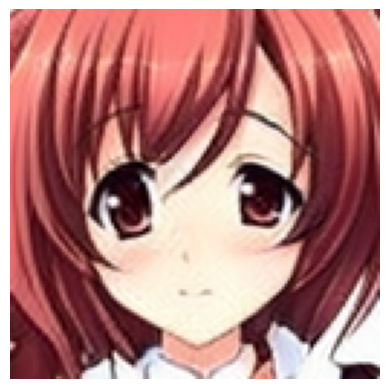

Seed:  800


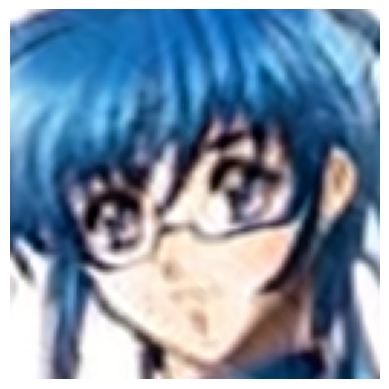

In [32]:
seed_list = [4210, 4262, 4295, 4218, 500, 800]

for s in seed_list:
  print('Seed: ', s)
  z = generate_z(G, s)
  img = generate_image(device, G, z)
  show_img(img)

Seed:  217


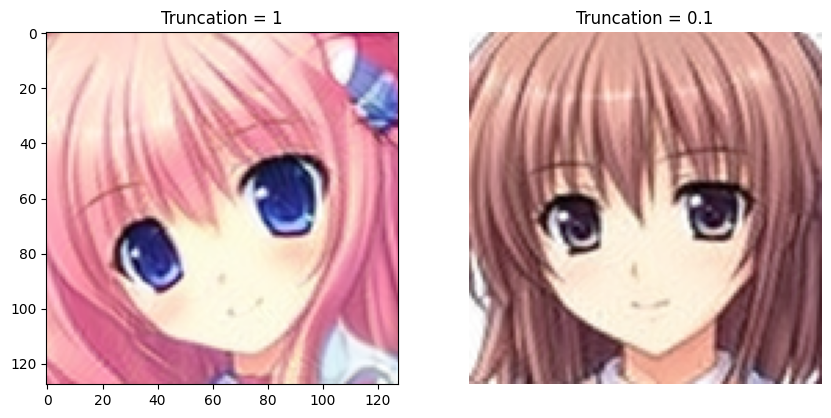

Seed:  217


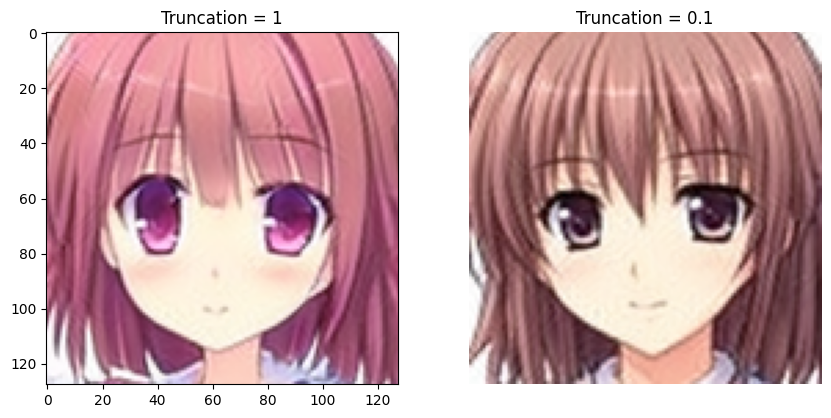

Seed:  217


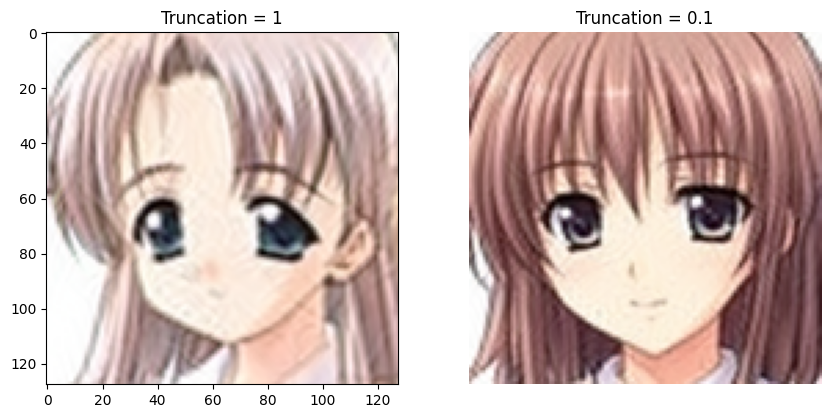

Seed:  217


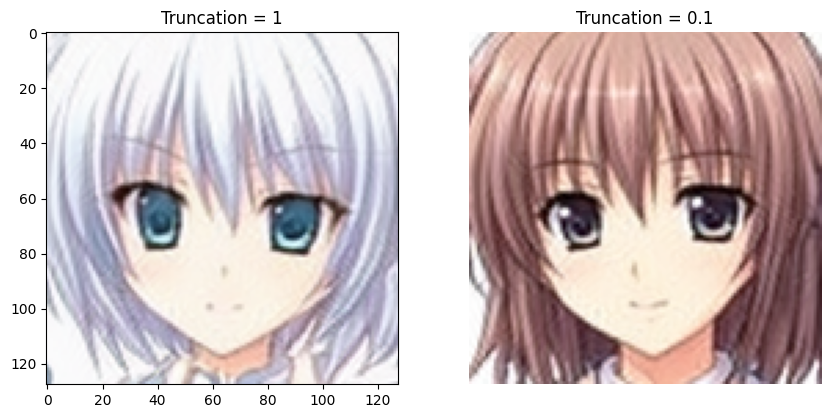

Seed:  217


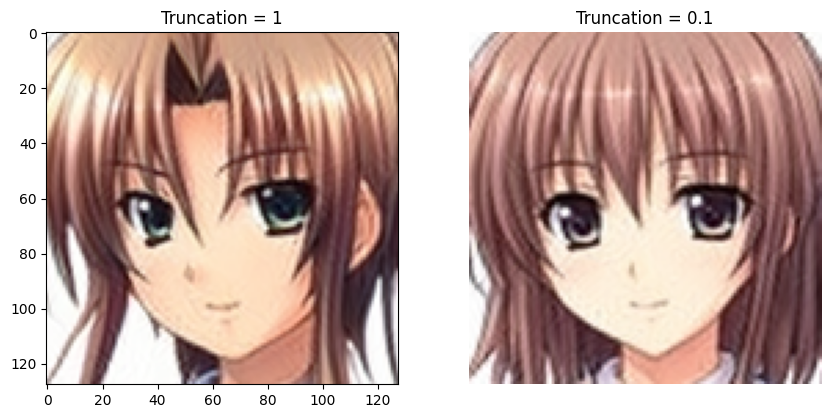

Seed:  217


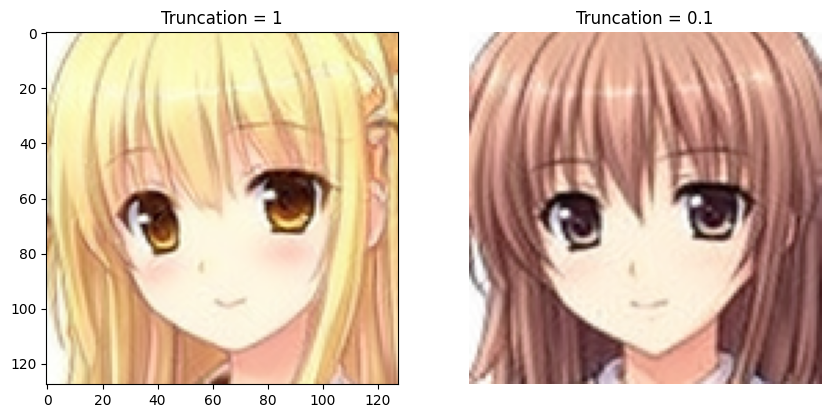

Seed:  217


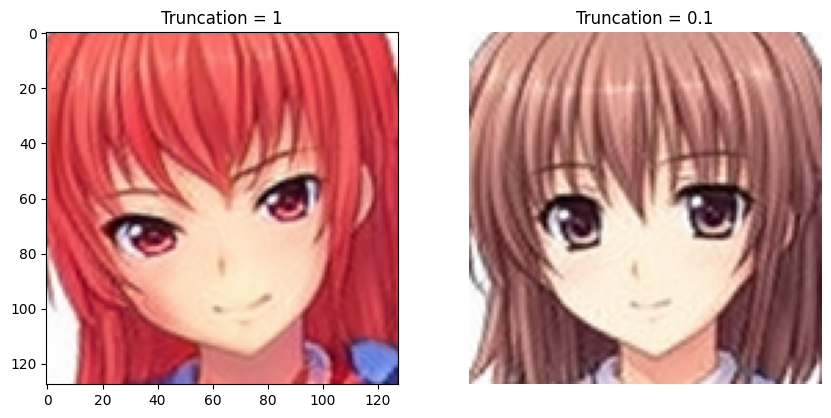

Seed:  217


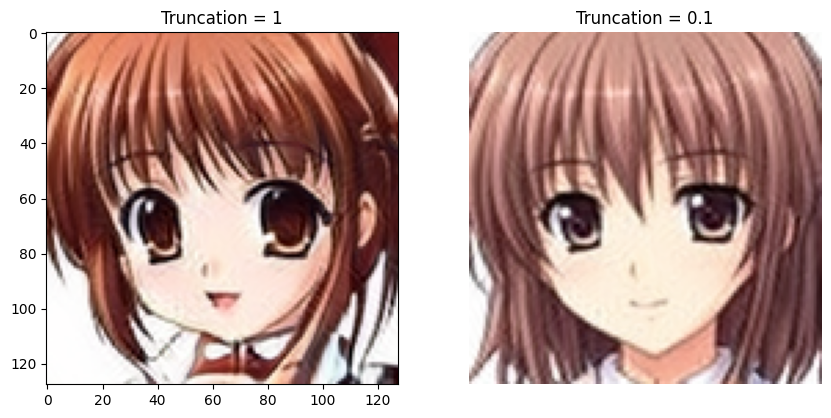

Seed:  217


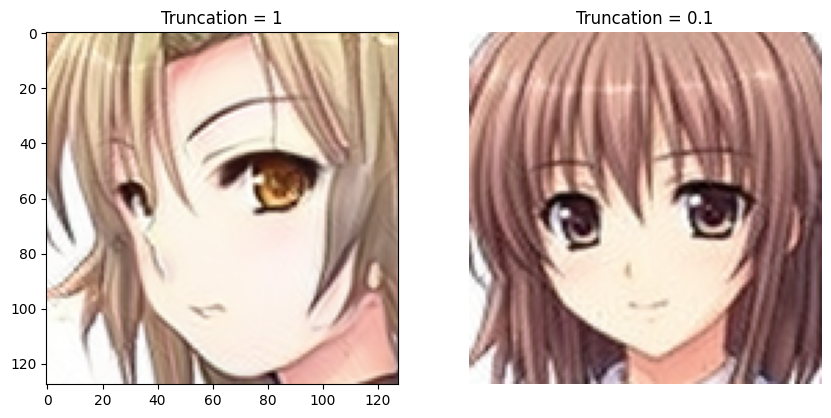

Seed:  217


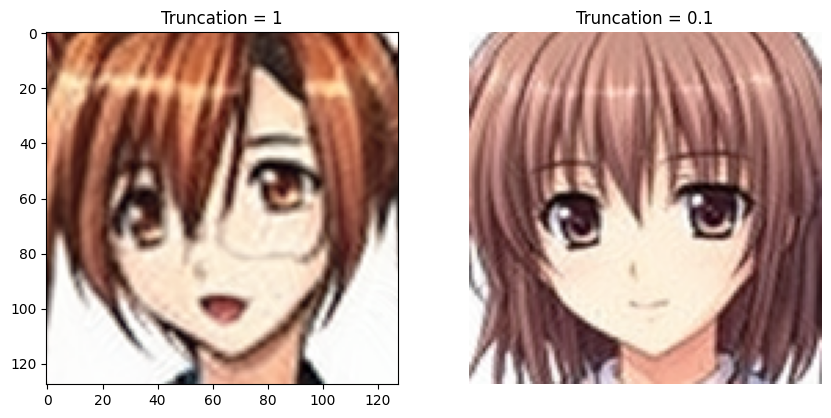

Seed:  217


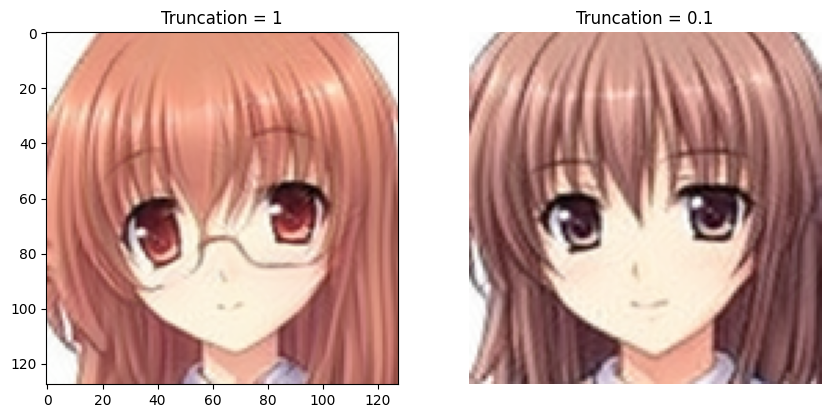

Seed:  217


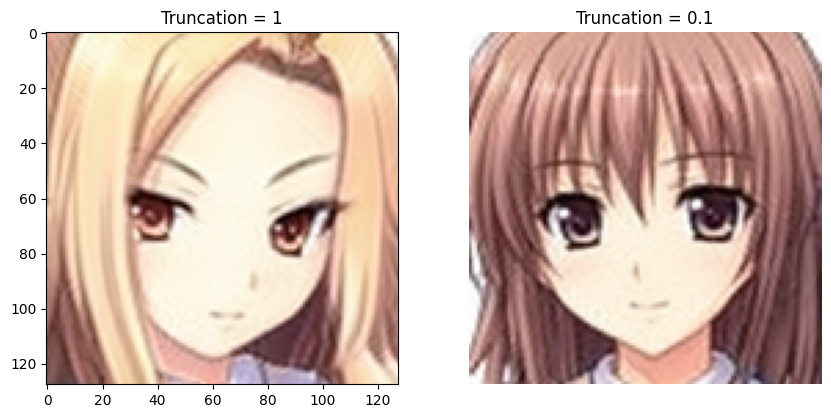

Seed:  217


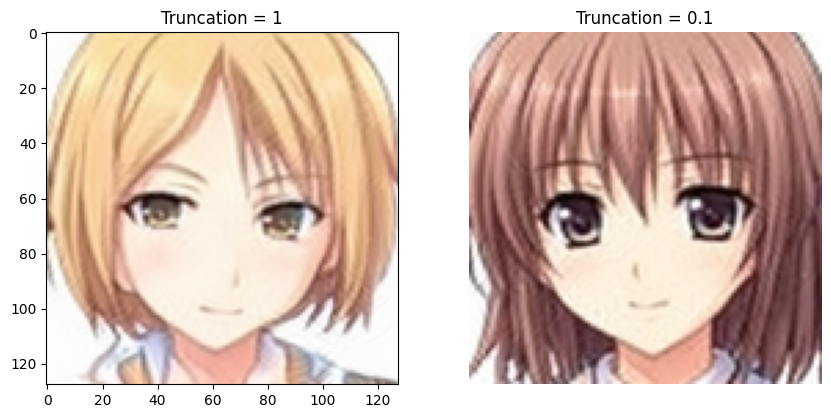

Seed:  217


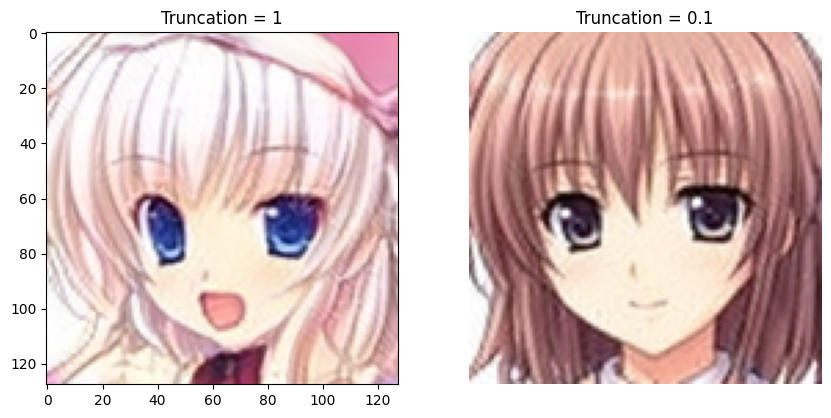

Seed:  217


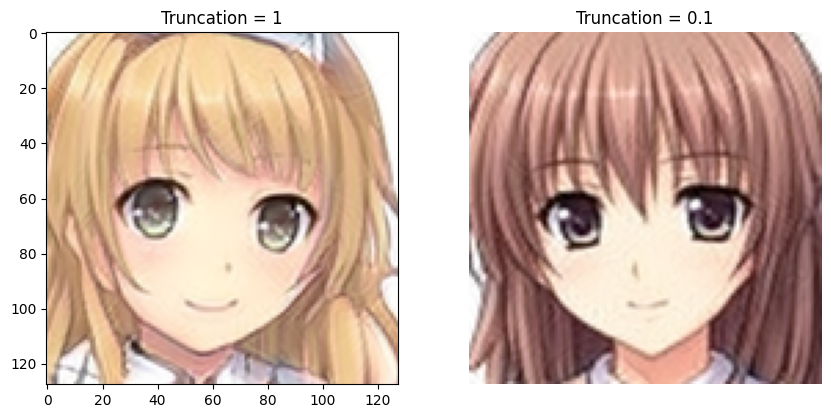

Seed:  217


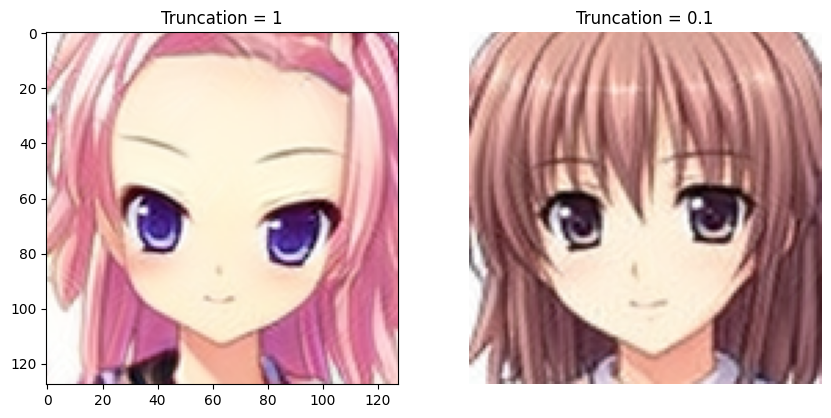

Seed:  217


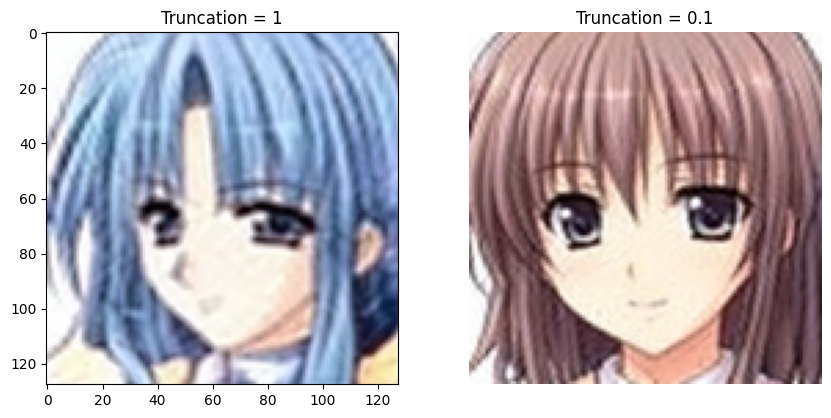

Seed:  217


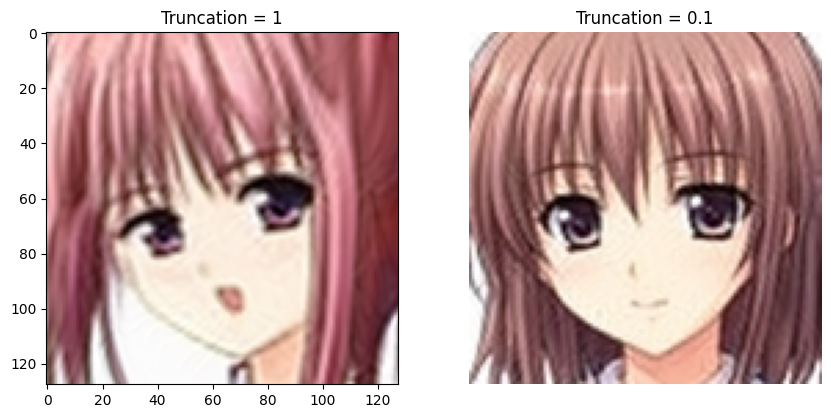

Seed:  217


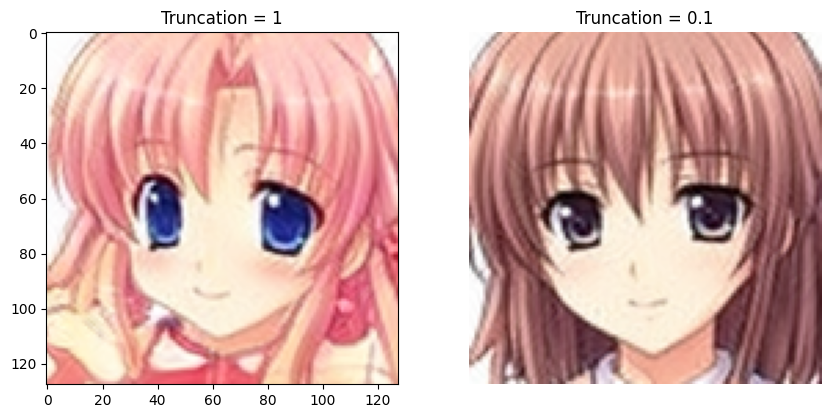

Seed:  217


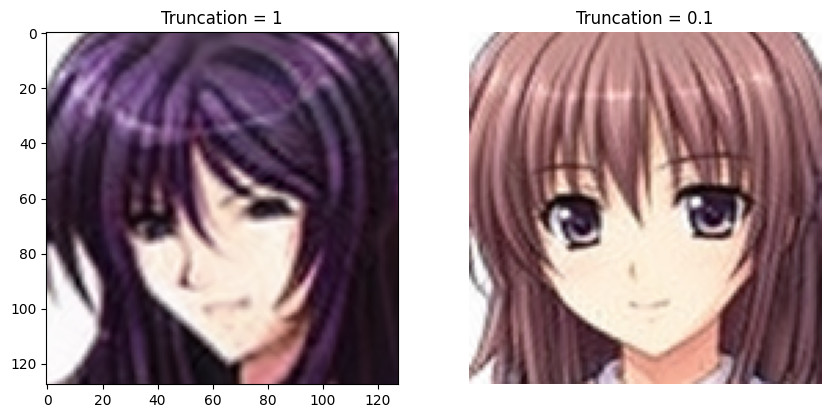

Seed:  217


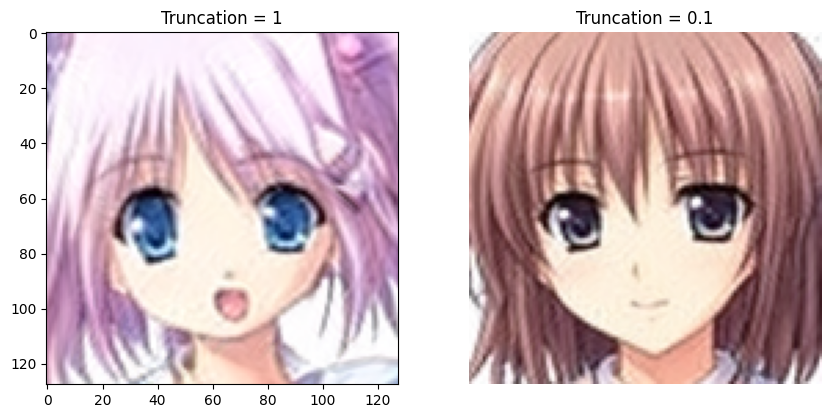

Seed:  217


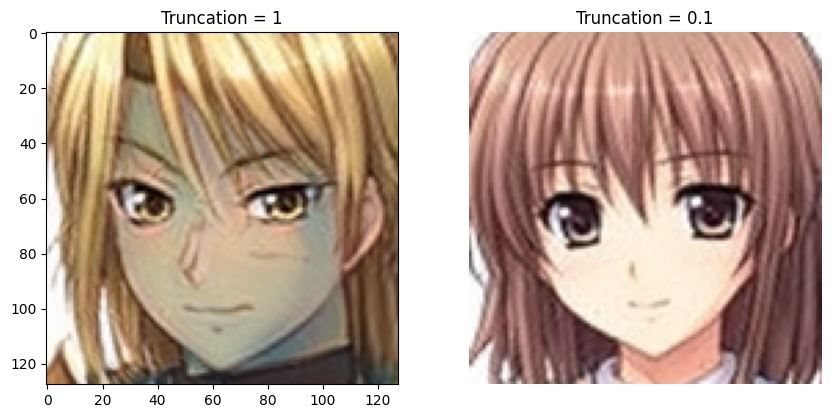

Seed:  217


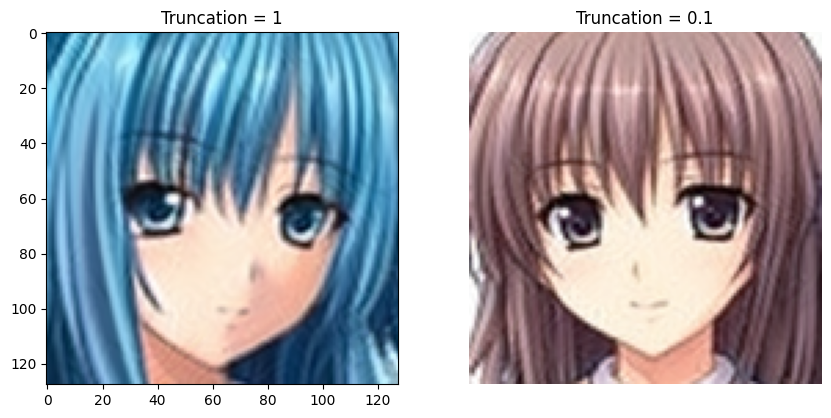

Seed:  217


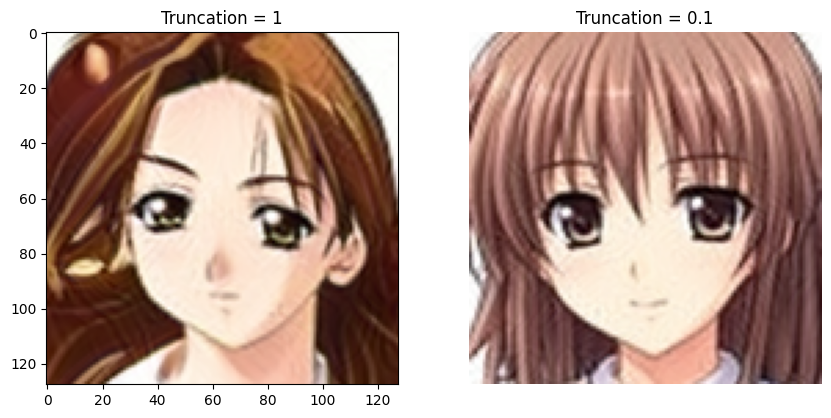

Seed:  217


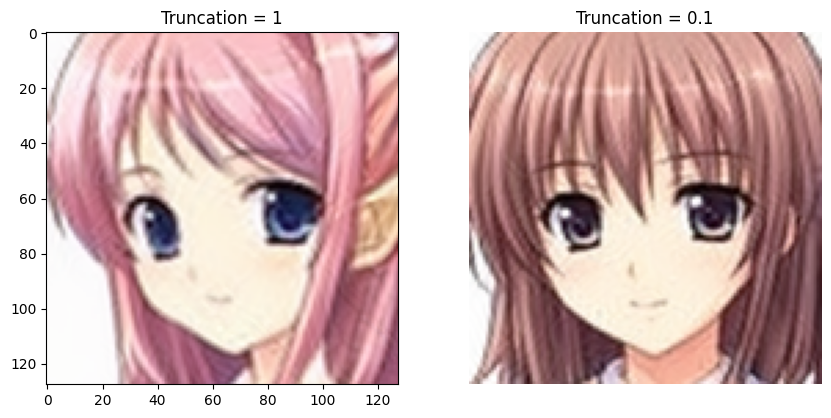

Seed:  217


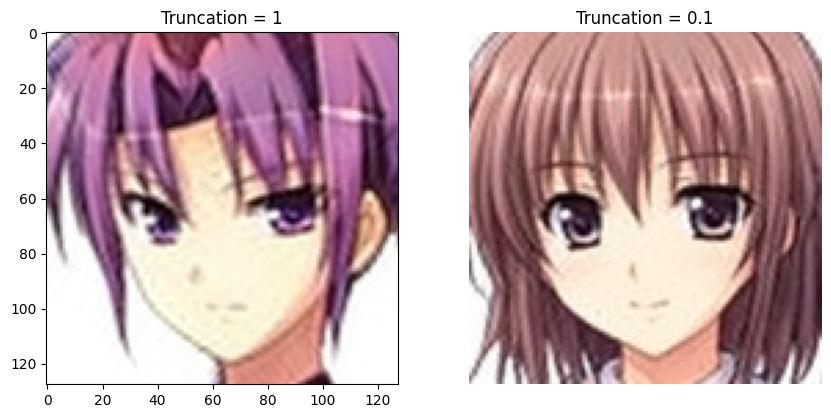

Seed:  217


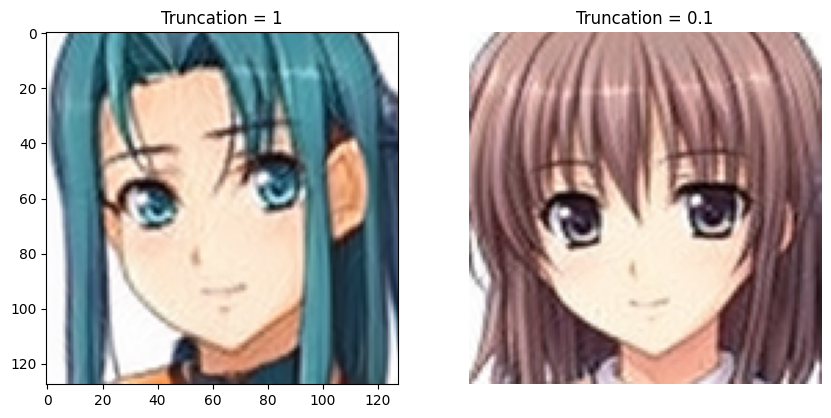

Seed:  217


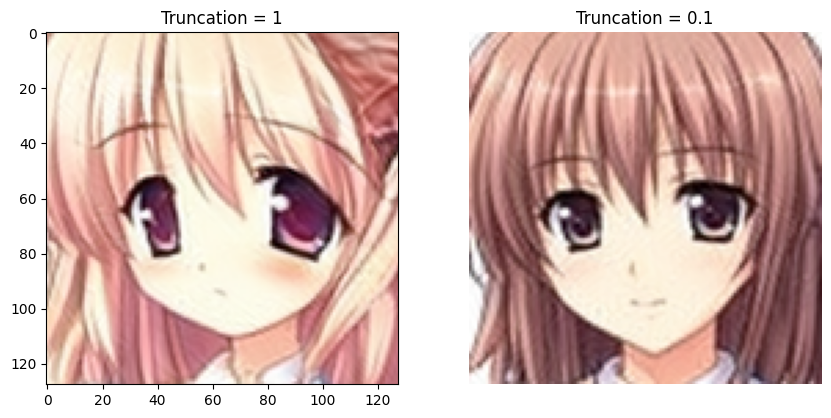

Seed:  217


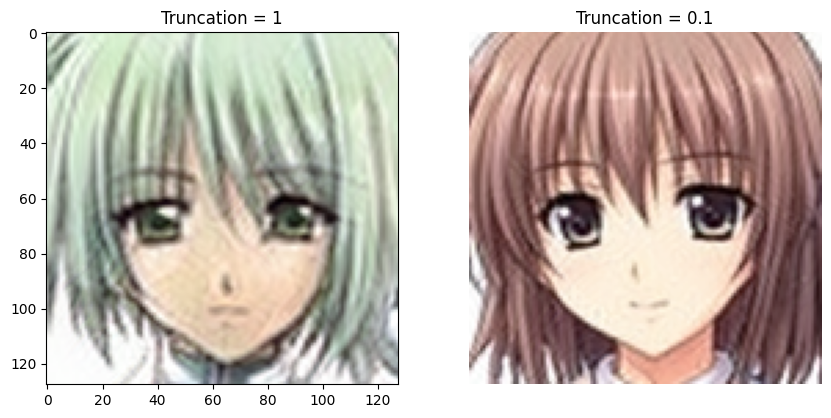

Seed:  217


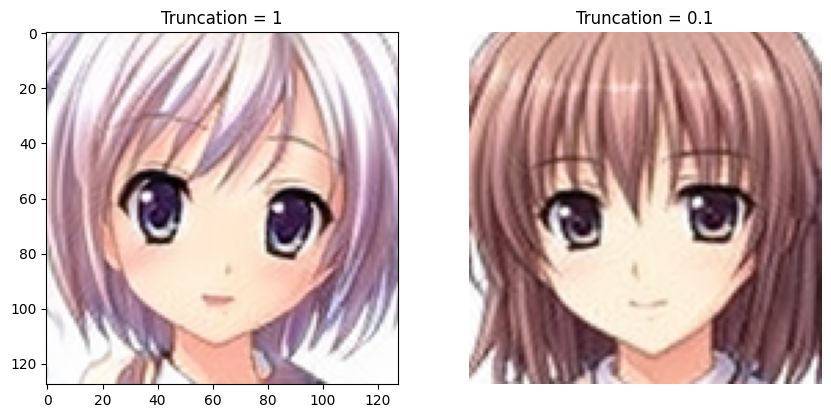

Seed:  217


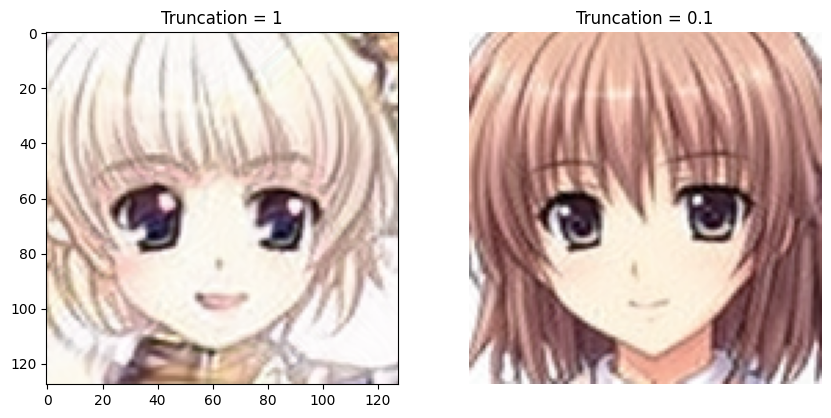

Seed:  217


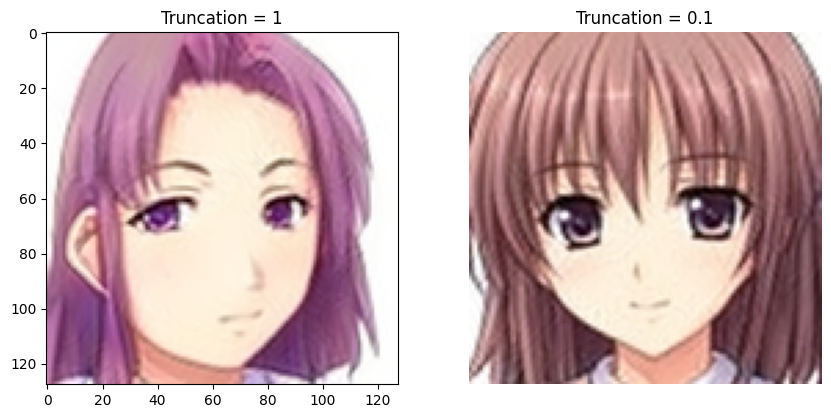

Seed:  217


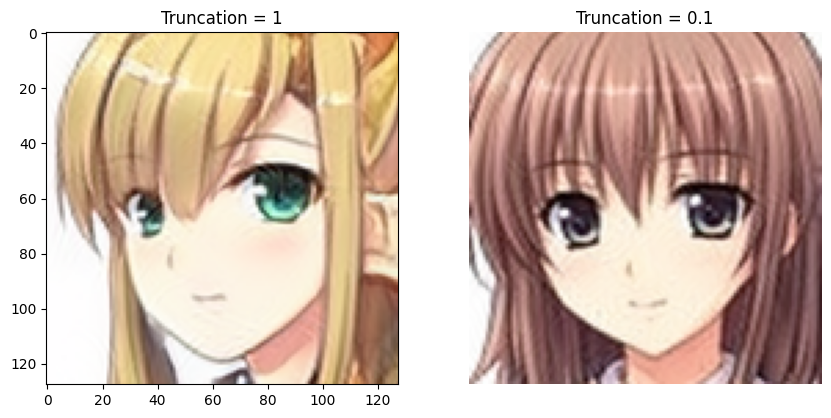

Seed:  217


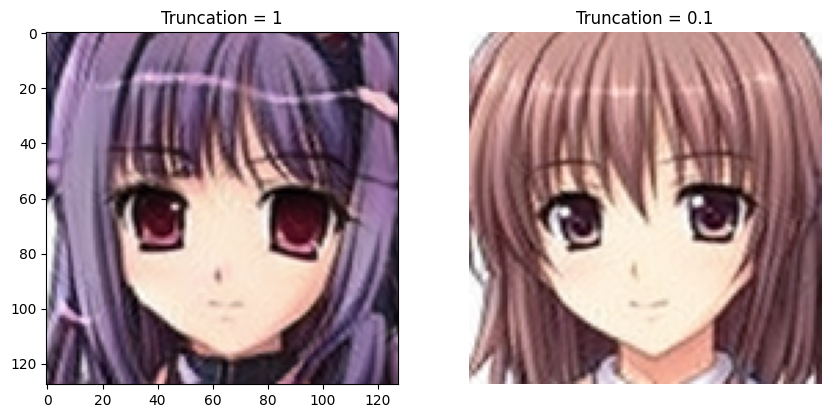

Seed:  217


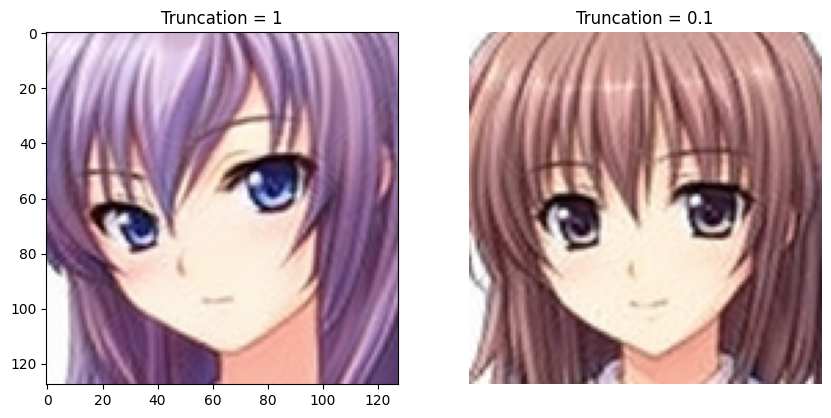

Seed:  217


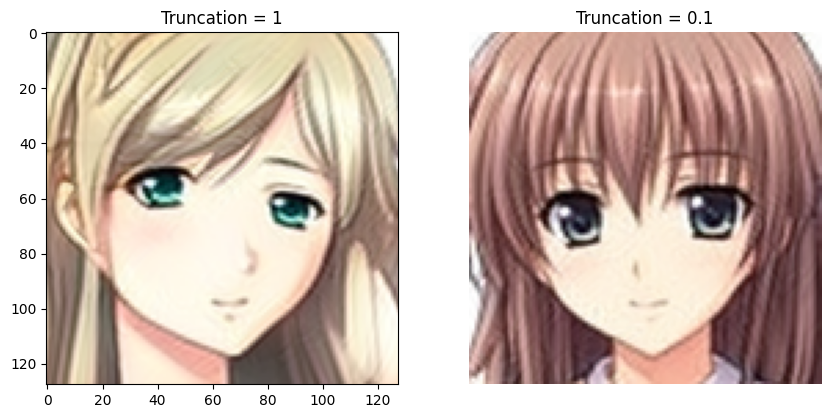

Seed:  217


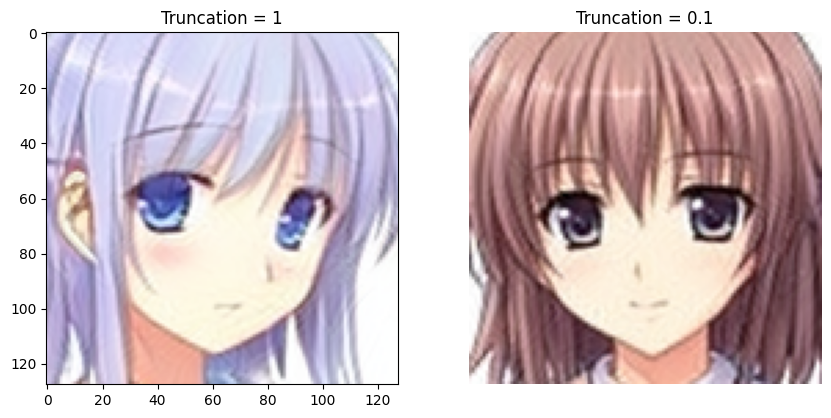

Seed:  217


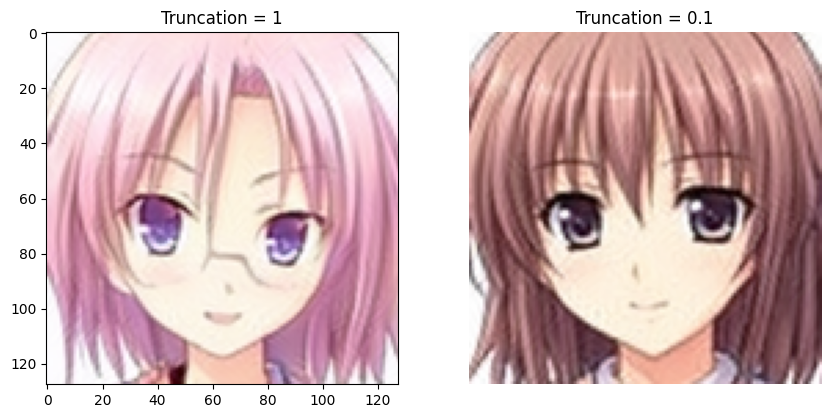

Seed:  217


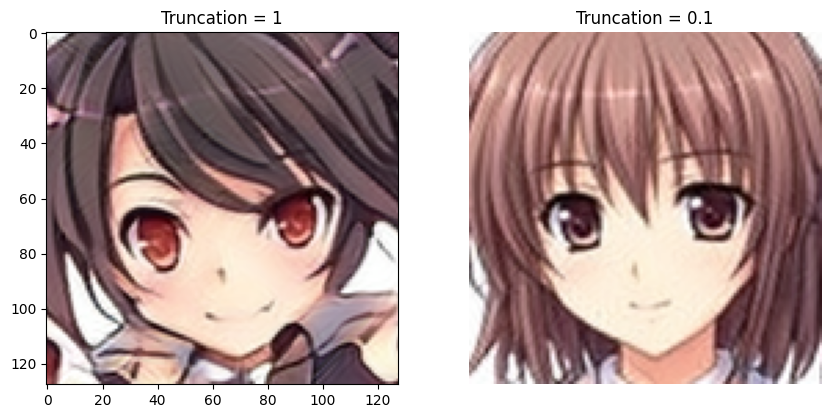

Seed:  217


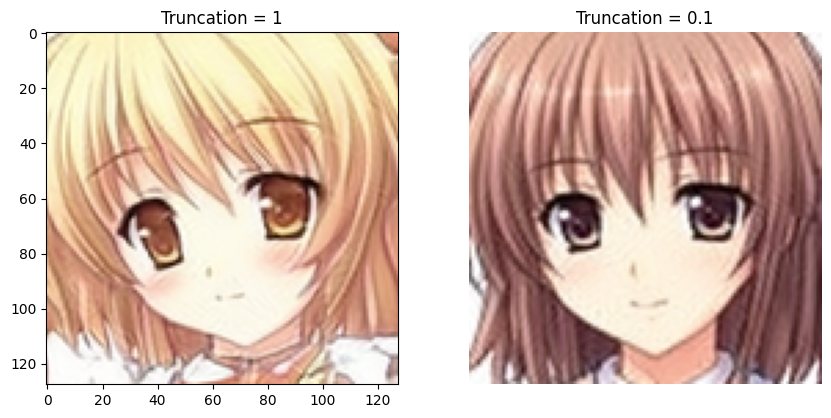

Seed:  217


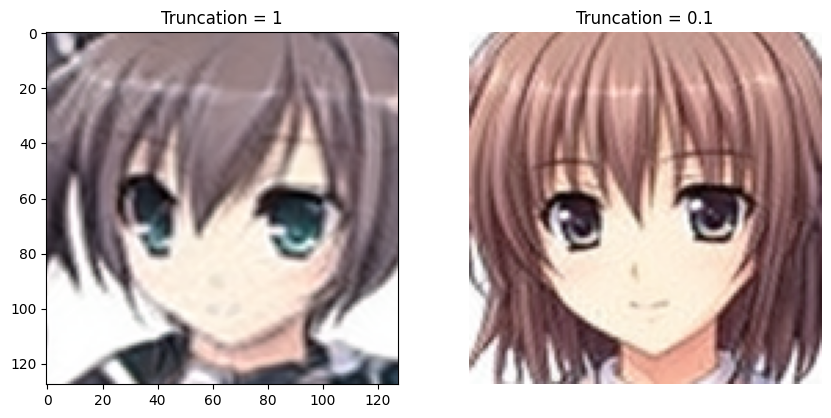

Seed:  217


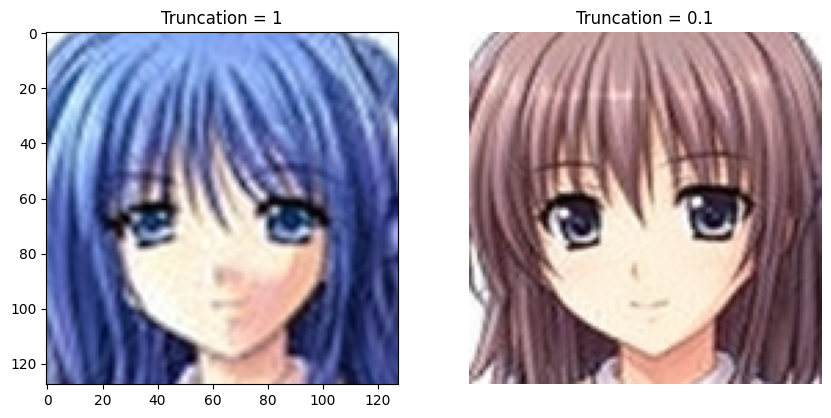

Seed:  217


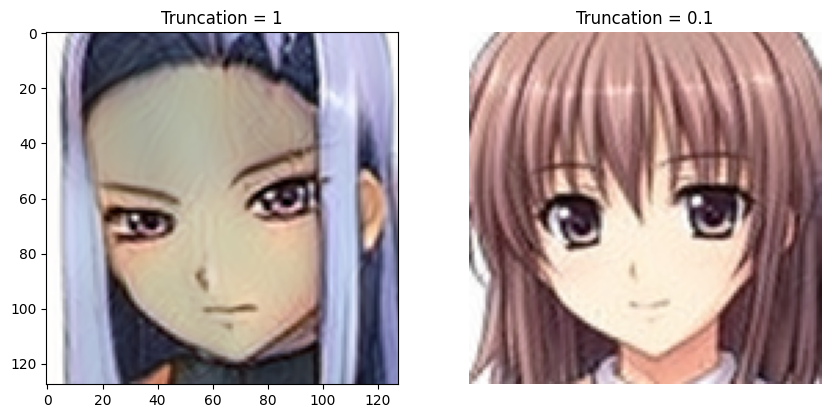

Seed:  217


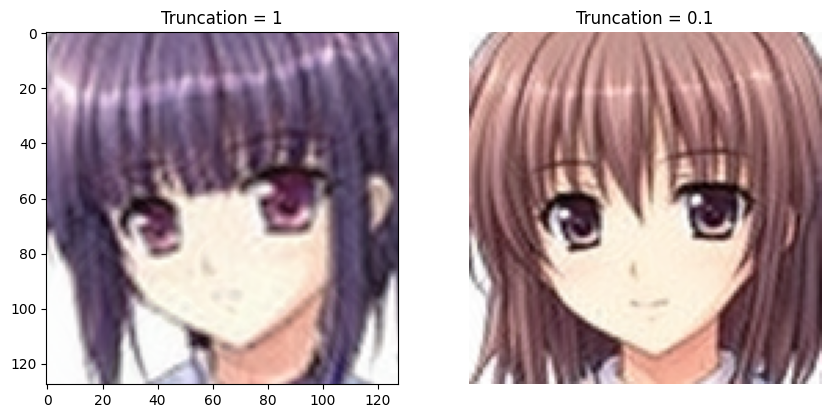

Seed:  217


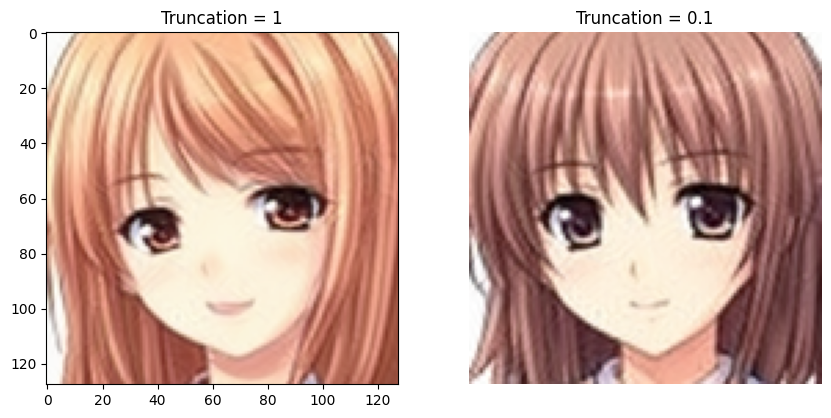

Seed:  217


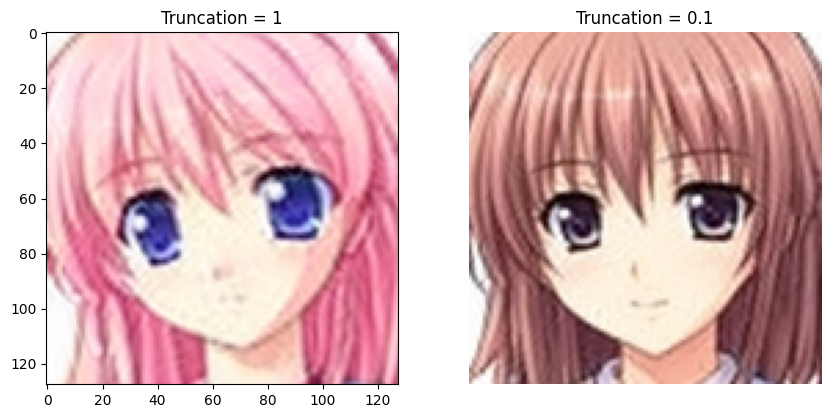

Seed:  217


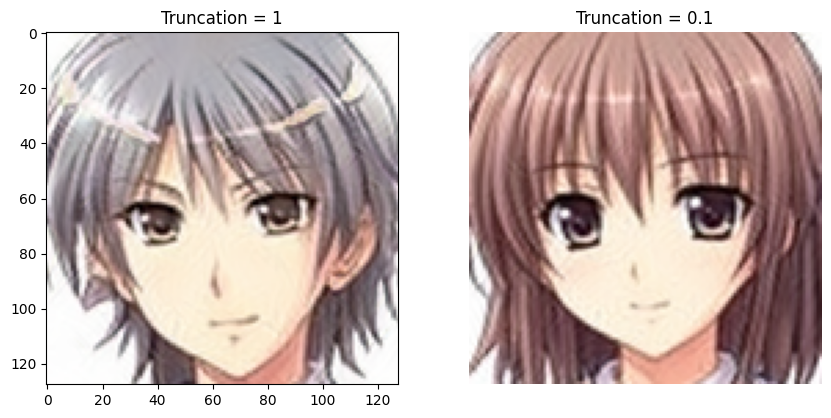

Seed:  217


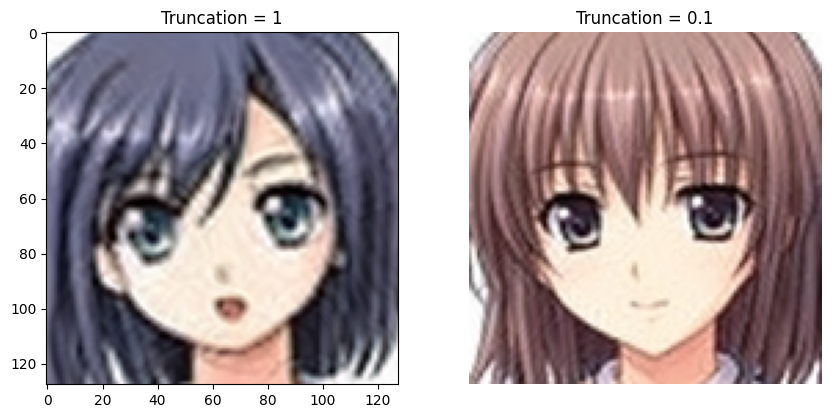

Seed:  217


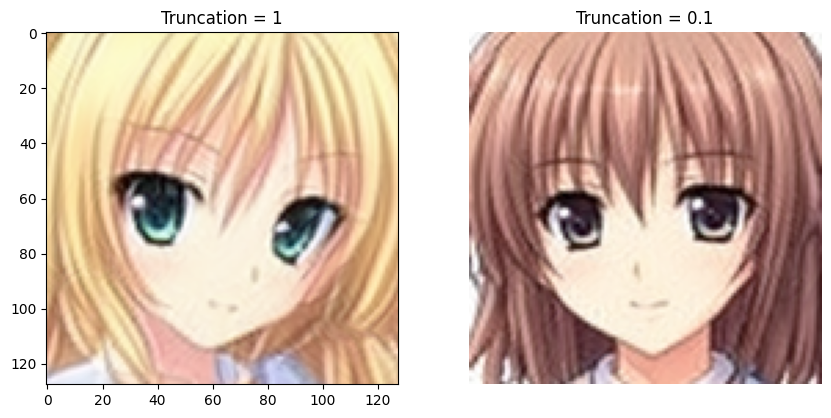

Seed:  217


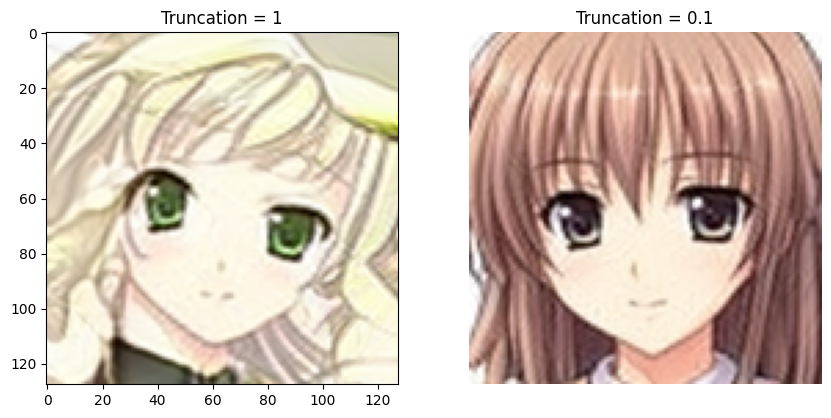

Seed:  217


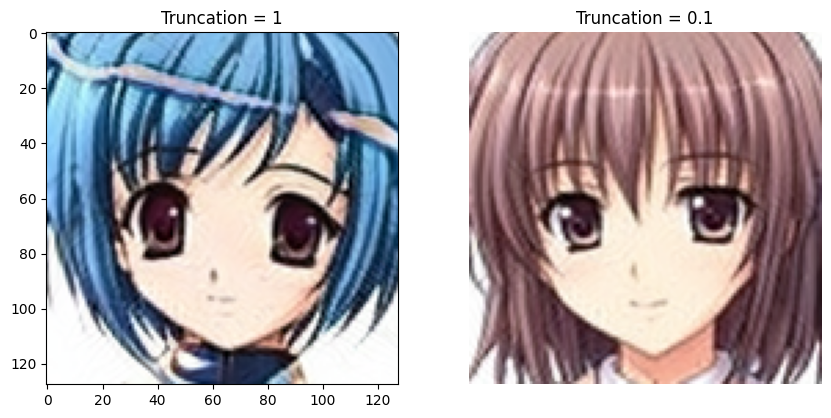

In [33]:
seed_start = 1  # @param {type: "slider", min:1, max:999, step:1}
seed_end = 51  # @param {type: "slider", min:1, max:999, step:1}
custom_truncation = 0.1

for s in range(seed_start, seed_end+1):
  plt.figure(figsize=(10,6))
  print('Seed: ', seed)
  z = generate_z(G, s)

  image = generate_image(device, G, z)
  image2 = generate_image(device, G, z, custom_truncation)
  plt.subplot(1,2,1)
  plt.title('Truncation = 1')
  plt.imshow(image)

  plt.subplot(1,2,2)
  plt.title('Truncation = {}'.format(custom_truncation))
  plt.imshow(image2)

  plt.axis('off')
  plt.show()

# **Generate Gif**

In [21]:
from tqdm.notebook import tqdm as log_progress

In [22]:
os.makedirs('/content/interpolation/', exist_ok = True)

In [41]:
# Set parameters for seed values and number of vectors
seed_start = 1  # @param {type: "slider", min: 1, max: 999, step: 1}
seed_end = 244  # @param {type: "slider", min: 1, max: 999, step: 1}
num_vectors = 45  # @param {type: "slider", min: 1, max: 999, step: 1}

# Prepare the seed values list
seeds = [seed_start, seed_end]

def interpolation(seeds: list, num_vectors: int, truncation: float = 1) -> list:
    """
    Interpolate between latent vectors generated from seed values and return the generated images.

    Args:
    - seeds (list): List of seed values to generate latent vectors.
    - num_vectors (int): Number of interpolation steps between latent vectors.
    - truncation (float, optional): The truncation value to apply during image generation. Default is 1.

    Returns:
    - List of generated images during the interpolation process.
    """
    interpolation_images = []
    idx = 0

    for i in range(len(seeds) - 1):
        latent1 = generate_z(G, seeds[i])
        latent2 = generate_z(G, seeds[i + 1])

        # Compute the difference and step for interpolation
        difference = latent2 - latent1
        step = difference / num_vectors
        current = latent1.copy()

        for j in log_progress(range(num_vectors), desc=f'Seed {seeds[i]}'):
            current = current + step
            image = generate_image(device, G, current, truncation)
            interpolation_images.append(image)
            image.save(f'/content/interpolation/frame-{idx}.png')
            idx += 1

    return interpolation_images


In [42]:
interpolation_images = interpolation(seeds, num_vectors, 0.7)

Seed 1:   0%|          | 0/45 [00:00<?, ?it/s]

In [43]:
from math import ceil
from google.colab.patches import cv2_imshow
from PIL import Image
import numpy as np
import cv2

def show_images_grid(images, scale=0.25, lines=1):
    w, h = images[0].size
    w = int(w * scale)
    h = int(h * scale)
    height = lines * h
    cols = ceil(len(images) / lines)
    width = cols * w
    grid = Image.new('RGBA', (width, height), 'white')
    for i, img in enumerate(images):
        img = img.resize((w, h), Image.Resampling.LANCZOS)
        grid.paste(img, (w * (i % cols), h * (i // cols)))

    grid = np.array(grid)
    return grid

def show_full_image(image):
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    return cv2_imshow(image)

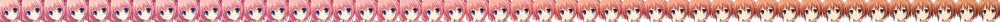

In [44]:
grid_images = show_images_grid(interpolation_images)
show_full_image(grid_images)

In [45]:
import imageio
from IPython.display import Image as displayImage

def create_gif(output_file, images_interpolation):
  with imageio.get_writer(output_file, mode='I', duration=0.15) as writer:

    for i, image in enumerate(images_interpolation):
      frame_anim = np.array(image)
      frame_anim = cv2.resize(frame_anim, (300,300))
      writer.append_data(frame_anim)

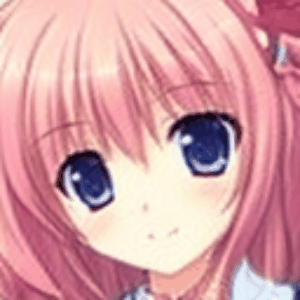

In [46]:
output_file = 'animination.gif'
create_gif(output_file, interpolation_images)
displayImage(open(output_file, 'rb').read())